# Numerical simulations

In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_formats = {'svg', 'png', 'retina'}

from matplotlib.ticker import AutoMinorLocator
import seaborn as sns

# sns.set_style("whitegrid")
plt.rcParams['svg.fonttype'] = 'none'
import os

# Ony necessary in MacOSX and Anaconda due to known error with duplicated symbol
# when using OpenMP
# This line can also be avoided installing anaconda's nomkl (conda install nomkl)
os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [2]:
import egttools as egt

In [3]:
egt.Random.init()
seed = egt.Random._seed

In [4]:
# Payoff matrix
V = 2; D = 3; T = 1
A = np.array([
        [ (V-D)/2, V], # Hawks
        [ 0      , (V/2) - T], # Doves
    ])

## Estimate numerically the stationary distribution

In [5]:
game = egt.games.NormalFormGame(1, A)

In [6]:
Z = 100
x = np.arange(0, Z+1)/Z

In [7]:
evolver = egt.numerical.PairwiseMoran(Z, game, 1000000)

In [8]:
Z = 100
x = np.arange(0, Z+1)/Z
evolver.pop_size = Z

In [9]:
dist = evolver.estimate_stationary_distribution(10, int(1e6), int(1e3), 1, 1e-3)

In [10]:
analytical_evolver = egt.analytical.StochDynamics(2, A, Z, mu=1e-3)
analytical_dist = analytical_evolver.calculate_stationary_distribution(1)

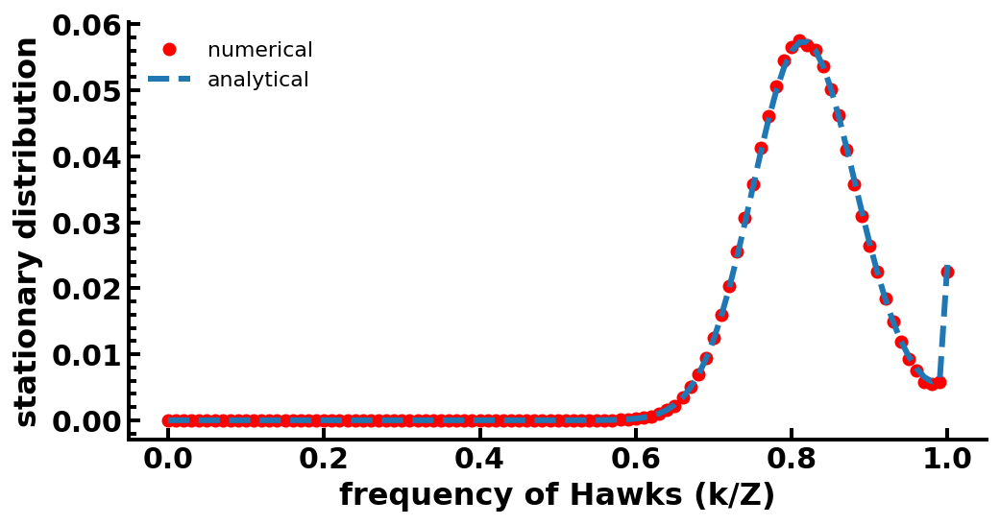

In [11]:
sns.set_context("notebook", rc={"lines.linewidth": 3, "axes.linewidth": 2})
# We need to reverse, since in this case we are starting from the case
# where the number of Haws is 100%, because of how we map states
fig, ax = plt.subplots(figsize=(8, 4))

lines1 = ax.plot(x, list(reversed(dist)), 'o', color='red', label='numerical')
lines2 = ax.plot(x, list(reversed(analytical_dist)), '--', label='analytical')
ax.legend(frameon=False)

ax.set_ylabel('stationary distribution', size=16, fontweight='bold')
ax.set_xlabel('frequency of Hawks (k/Z)', size=16, fontweight='bold')
ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.tick_params(axis='x', which='both', direction='in', labelsize=15, width=2)
ax.tick_params(axis='y', which='both', direction='in', labelsize=15, width=2)

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')

sns.despine()

### We can also plot a single run

In [12]:
output = evolver.run(int(1e6), 1, 1e-3, [0, Z])

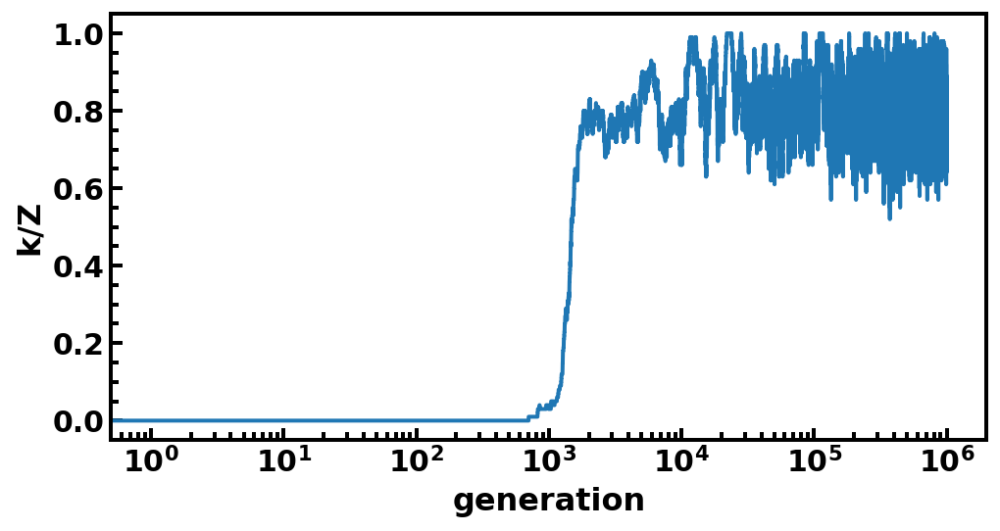

In [13]:
fig, ax = plt.subplots(figsize=(8, 4))

lines = ax.plot(output[:, 0]/Z)
plt.setp(lines, linewidth=2)

ax.set_ylabel('k/Z', size=16, fontweight='bold')
ax.set_xlabel('generation', size=16, fontweight='bold')

ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.tick_params(axis='x', which='both', direction='in', labelsize=15, width=2)
ax.tick_params(axis='y', which='both', direction='in', labelsize=15, width=2)

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')

ax.set_xscale('log')
plt.show()

### And can visualize what happens if we start several runs from random points in the simplex

In [14]:
init_states = np.random.randint(0, Z+1, size=10, dtype=np.uint64)

In [15]:
output = []
for i in range(10):
    output.append(evolver.run(int(1e6), 1, 1e-3, 
                              [init_states[i], Z - init_states[i]]))

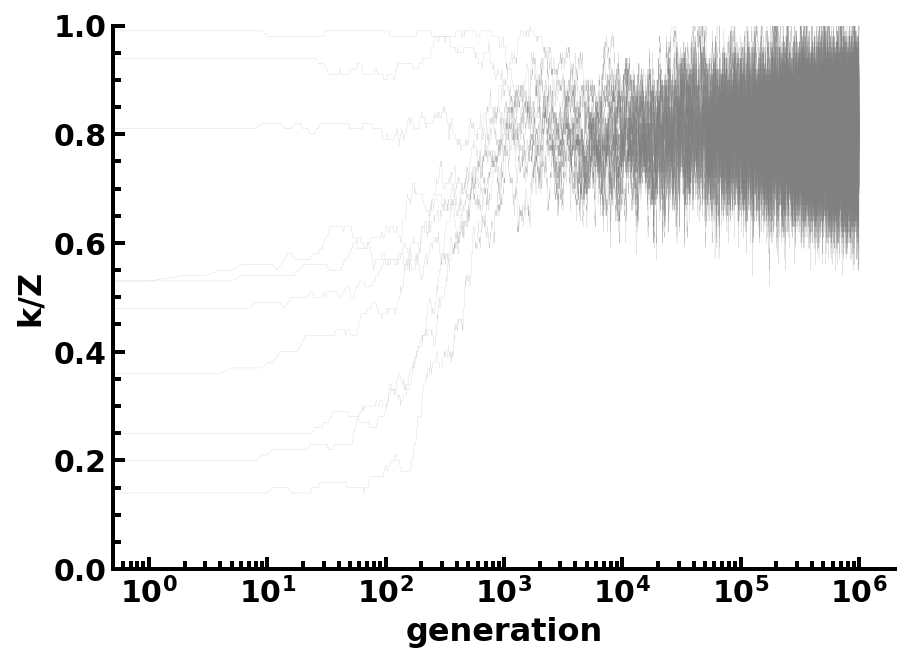

In [16]:
fig, ax = plt.subplots(figsize=(7, 5))

for run in output:
    ax.plot(run[:, 0]/Z, color='gray', linewidth=.1, alpha=0.6) 
ax.set_ylabel('k/Z', size=16, fontweight='bold')
ax.set_xlabel('generation', size=16, fontweight='bold')
ax.set_xscale('log')
ax.set_ylim(0, 1)

ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.tick_params(axis='x', which='both', direction='in', labelsize=15, width=2)
ax.tick_params(axis='y', which='both', direction='in', labelsize=15, width=2)

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')

ax.set_xscale('log')
sns.despine()
plt.show()

### And we can also compare how far our approximations are from the analytical results

In [17]:
# We do this for different betas
betas = np.logspace(-4, 1, 50)

In [18]:
stationary_points = []
for i in range(len(betas)):
    stationary_points.append(evolver.estimate_stationary_distribution_sparse(30, int(1e6), int(1e3), 
                                                             betas[i], 1e-3).toarray()[0])
stationary_points = np.asarray(stationary_points)

In [19]:
# Now we estimate the probability of Cooperation for each possible state
state_frequencies = np.arange(0, Z+1) / Z
coop_level = np.dot(state_frequencies, stationary_points.T)

In [20]:
# Finnally we do the same, but for the analytical results
from egttools.analytical import StochDynamics

In [21]:
analytical_evolver = egt.analytical.StochDynamics(2, A, Z, mu=1e-3)

In [22]:
stationary_points_analytical = []
for i in range(len(betas)):
    stationary_points_analytical.append(analytical_evolver.calculate_stationary_distribution(betas[i]))
stationary_points_analytical = np.asarray(stationary_points_analytical)

In [23]:
# Now we estimate the probability of Cooperation for each possible state
coop_level_analytical = np.dot(1 - state_frequencies, stationary_points_analytical.T)

In [24]:
from sklearn.metrics import mean_squared_error

In [25]:
mse = mean_squared_error(coop_level_analytical, coop_level)

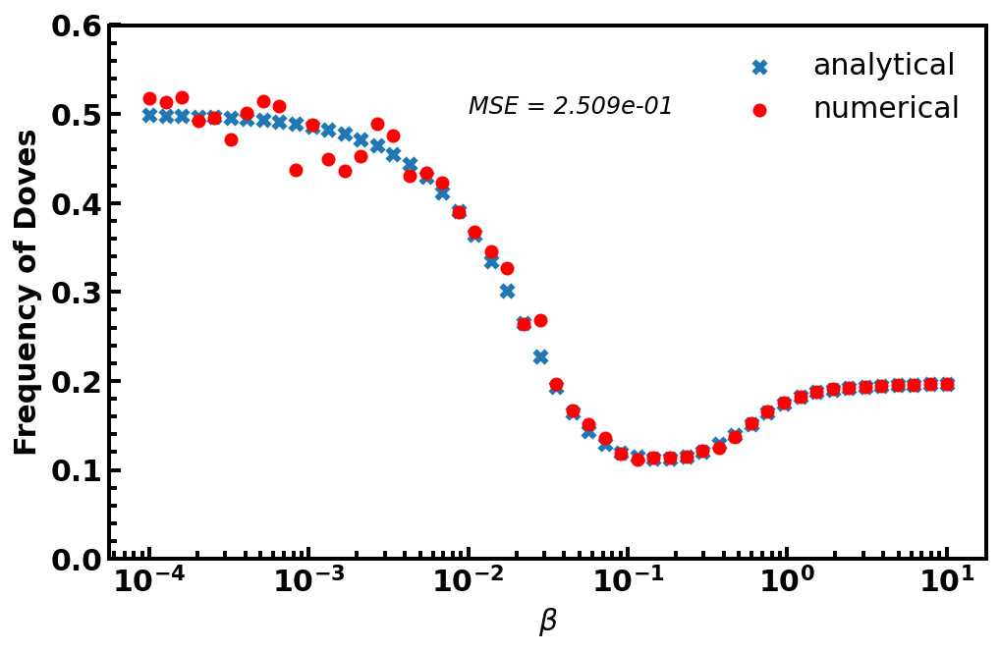

In [26]:
# Finally, we plot and compare visually (and check how much error we get)
fig, ax = plt.subplots(figsize=(8, 5))
# ax.scatter(betas, coop_level, label="simulation")
ax.scatter(betas, 1-coop_level_analytical, marker='x', label="analytical")
ax.scatter(betas, coop_level, marker='o', label="numerical", color='red')
ax.text(0.01, 0.5, 'MSE = {0:.3e}'.format(mse), style='italic')
ax.legend(frameon=False, fontsize=15)
ax.set_xlabel(r'$\beta$', fontsize=15, fontweight='bold')
ax.set_ylabel(r'Frequency of Doves', fontsize=15, fontweight='bold')
ax.set_xscale('log')
ax.set_ylim(0, 0.6)


ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.tick_params(axis='x', which='both', direction='in', labelsize=15, width=2)
ax.tick_params(axis='y', which='both', direction='in', labelsize=15, width=2)

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')

plt.show()

## Iterated Prisoner's Dilemma

In [27]:
from egttools.behaviors.NormalForm.TwoActions import (Cooperator,Defector, TFT, 
                                                                Pavlov, GRIM, 
                                                                Random)

In [28]:
strategies = [Cooperator(), Defector(), TFT(), 
              Pavlov(), Random(), GRIM()]

In [29]:
strategy_labels = [strategy.type().replace("NFGStrategies::", '') for strategy in strategies]

In [30]:
T = 3; R = 2; P = 1; S = 0

In [31]:
A = np.array([
    [P, T],
    [S, R]
])

In [32]:
Z = 100

In [33]:
game = egt.games.NormalFormGame(100, A, strategies)

In [34]:
game.expected_payoffs()

array([[2.      , 0.      , 2.      , 2.      , 1.001114, 2.      ],
       [3.      , 1.      , 1.02    , 2.      , 1.999292, 1.02    ],
       [2.      , 0.99    , 2.      , 2.      , 1.494626, 2.      ],
       [2.      , 0.5     , 2.      , 2.      , 1.495848, 2.      ],
       [2.499443, 0.500354, 1.509494, 1.510191, 1.500262, 0.540899],
       [2.      , 0.99    , 2.      , 2.      , 1.978247, 2.      ]])

### Single run

In [35]:
evolver = egt.numerical.PairwiseMoran(Z, game, 1000000)

In [36]:
output = evolver.run(int(1e7), 1, 1e-3, [0, 0, 40, 10, 0, 50])

In [37]:
colors = sns.color_palette("colorblind", len(strategies))

In [38]:
from cycler import cycler

In [39]:
plt.rc('axes', prop_cycle=(cycler('color', colors)))

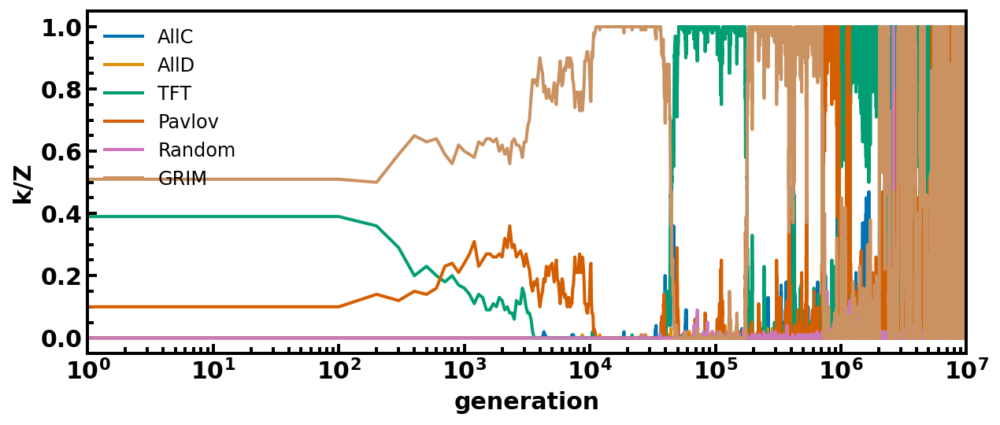

In [40]:
fig, ax = plt.subplots(figsize=(10, 4))

lines = ax.plot(np.arange(1e7+1)[::100], output[::100]/Z)
plt.setp(lines, linewidth=2)

ax.legend([s for s in strategy_labels], frameon=False, fontsize=12)
ax.set_ylabel('k/Z', fontsize=15, fontweight='bold')
ax.set_xlabel('generation', fontsize=15, fontweight='bold')
ax.set_xscale('log')
ax.set_xlim(1, 1e7)

ax.yaxis.set_minor_locator(AutoMinorLocator())
ax.tick_params(axis='x', which='both', direction='in', labelsize=15, width=2)
ax.tick_params(axis='y', which='both', direction='in', labelsize=15, width=2)

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontweight('bold')

plt.show()

In [41]:
distribution = evolver.estimate_strategy_distribution(10, int(1e7), int(1e3), 1, 1e-3)

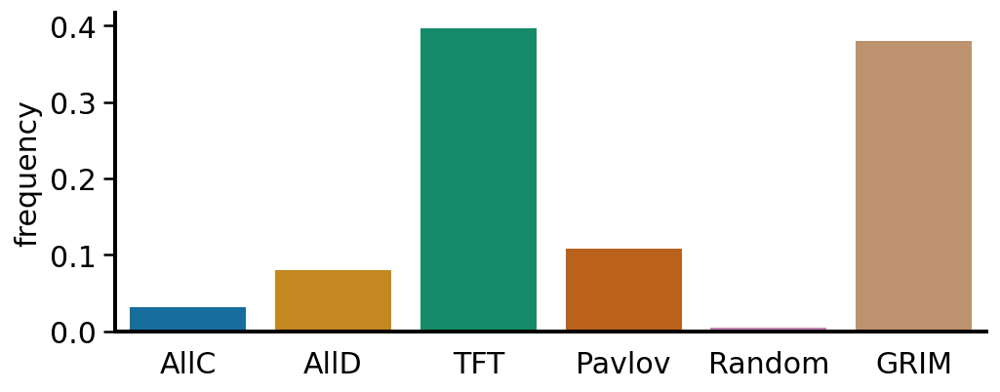

In [42]:
fig, ax = plt.subplots(figsize=(8, 3))

ax = sns.barplot(x=strategy_labels, y=distribution)

ax.set_ylabel('frequency', fontsize=15)
ax.tick_params(bottom = False, labelsize=15)
sns.despine()

## Plot the simplex between 3 strategies

In [43]:
from egttools.plotting.simplified import plot_replicator_dynamics_in_simplex, plot_moran_dynamics_in_simplex

In [44]:
type_labels = ['allD', 'Pavlov', 'GRIM']

In [45]:
strategies = [Defector(), Pavlov(), GRIM()]

In [46]:
game = egt.games.NormalFormGame(100, A, strategies)

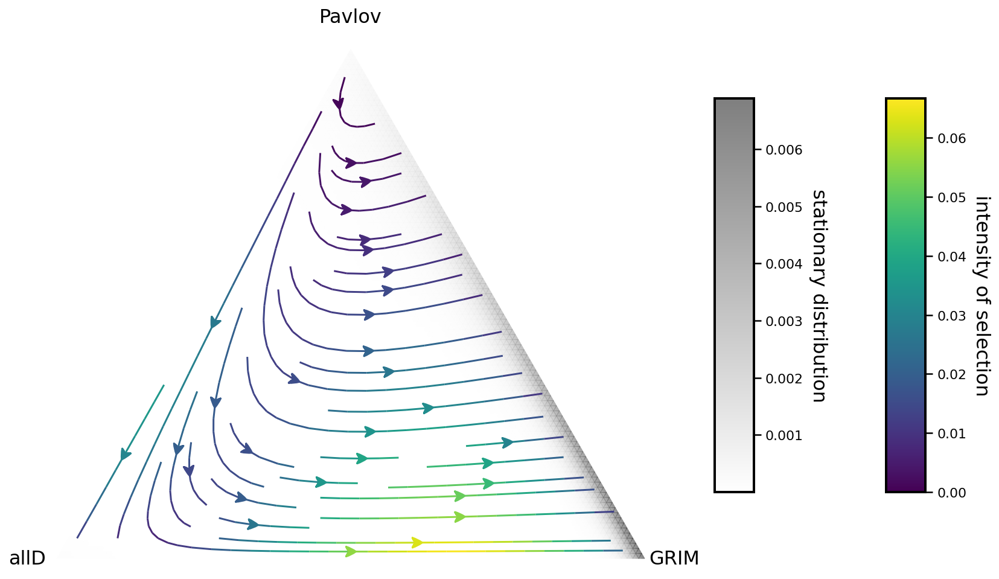

In [47]:
fig, ax = plt.subplots(figsize=(15,10))

simplex, gradients, roots, roots_xy, stability, evolver = plot_moran_dynamics_in_simplex(payoff_matrix=game.expected_payoffs(), population_size=Z, beta=1, ax=ax)

evolver.mu = 1/Z
transitions = evolver.calculate_full_transition_matrix(1)
sd = egt.utils.calculate_stationary_distribution_non_hermitian(transitions.toarray())

plot = (simplex.add_axis(ax=ax)
           .draw_gradients(zorder=5)
           .add_colorbar()
#            .draw_stationary_points(roots_xy, stability, zorder=11)
           .add_vertex_labels(type_labels)
           .draw_stationary_distribution(sd, alpha=0.5, edgecolors='gray', cmap='binary', shading='gouraud', zorder=0)
           .draw_trajectory_from_roots(lambda u, t: Z*evolver.full_gradient_selection_without_mutation(u, beta), 
                                       roots,
                                       stability,
                                       trajectory_length=30,
                                       linewidth=1,
                                       step=0.001,
                                       color='k', draw_arrow=True, arrowdirection='right', arrowsize=30, zorder=10, arrowstyle='fancy')
#            .draw_scatter_shadow(lambda u, t: Z*evolver.full_gradient_selection(u, beta), 300, color='gray', marker='.', s=0.1)
          )

ax.axis('off')
ax.set_aspect('equal')

plt.xlim((-.05,1.05))
plt.ylim((-.02, simplex.top_corner + 0.05))
plt.show()